In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

In [2]:
import scipy
from scipy import ndimage

In [3]:
import os

In [4]:
data_folder = "./data/flower_data/train/1/"

In [5]:
filename = "image_06737.jpg"

### Read data

In [6]:
image = cv2.imread(data_folder+filename)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

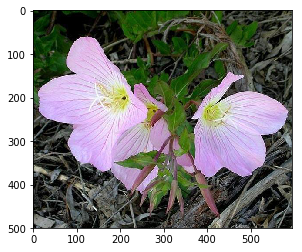

In [7]:
plt.imshow(image)
plt.show()

### points gen

In [8]:
rows,cols,ch = image.shape
print(rows, cols, ch)

500 595 3


In [9]:
delta = 0.15
margin = 30

In [10]:
# top-left, top right generate
tl = [(0+margin, 0+margin), (int(rows*delta), 0+margin), (0+margin, int(cols*delta)), (int(rows*delta), int(cols*delta))]
tr = [(cols-margin, 0+margin), (int(cols*(1-delta)), 0+margin), (cols-margin, int(rows*delta)), 
      (int(cols*(1-delta)), int(rows*delta))]

# bottom-left, bottom-right generate
bl = [(0+margin, rows-margin), (0+margin, int(rows*(1-delta))), (int(cols*delta), rows-margin), 
      (int(cols*delta), int(rows*(1-delta)))]
br = [(cols-margin, rows-margin), (int(cols*(1-delta)), rows-margin), (cols-margin, int(rows*(1-delta))), 
      (int(cols*(1-delta)), int(rows*(1-delta)))]

In [11]:
result = [(x,y,z,t) for x in tl for y in tr for z in bl for t in br]

In [12]:
len(result)

256

In [13]:
result[0]

((30, 30), (565, 30), (30, 470), (565, 470))

### new point gen

In [14]:
print(cols, rows)

595 500


In [15]:
delta = 0.15

In [16]:
src1 = np.float32([(0, 0), (int(cols*(1-delta)), int(rows*delta)), (int(cols*delta), int(rows*(1-delta))), (cols, rows)])

src2 = np.float32([(0, int(rows*2*delta)), (int(cols*(1-delta)), int(rows*delta)), 
                  (int(cols*delta), int(rows*(1-delta))), (cols, rows)])
src3 = np.float32([(0, 0), (int(cols*(1-delta)), int(rows*delta)), 
                  (int(cols*delta), int(rows*(1-delta))), (cols, int(rows*(1-2*delta)))])

src4 = np.float32([(int(cols*delta), int(rows*delta)), (cols, 0), (0, rows), (int(cols*(1-delta)), int(rows*(1-delta)))])

src5 = np.float32([(int(cols*delta), int(rows*delta)), (cols, int(rows*2*delta)), 
                  (0, rows), (int(cols*(1-delta)), int(rows*(1-delta)))])
src6 = np.float32([(int(cols*delta), int(rows*delta)), (cols, 0), 
                  (0, rows*(1-2*delta)), (int(cols*(1-delta)), int(rows*(1-delta)))])

src7 = np.float32([(int(cols*delta), int(rows*delta)), (cols, 0), (int(cols*2*delta), rows), 
                  (int(cols*(1-delta)), int(rows*(1-delta)))])
src8 = np.float32([(int(cols*delta), int(rows*delta)), (int(cols*(1-2*delta)), 0), (0, rows), 
                  (int(cols*(1-delta)), int(rows*(1-delta)))])

src9 = np.float32([(int(cols*2*delta), 0), (cols, int(rows*2*delta)), (0, rows*(1-2*delta)), (cols*(1-2*delta), rows)])
src10 = np.float32([(int(cols*delta), 0), (cols, int(rows*delta)), (0, int(rows*(1-delta))), (cols*(1-delta), rows)])

src11 = np.float32([(0, int(rows*delta)), (int(cols*(1-delta)), 0), (int(cols*delta), rows), (cols, int(rows*(1-delta)))])
src12 = np.float32([(0, int(rows*2*delta)), (int(cols*(1-2*delta)), 0), 
                    (int(cols*2*delta), rows), (cols, int(rows*(1-2*delta)))])

In [17]:
src = [src1, src2, src3, src4, src5, src6, src7, src8, src9, src10, src11, src12]

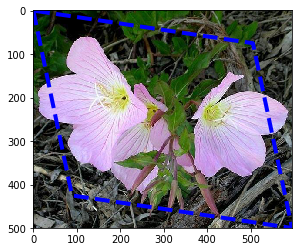

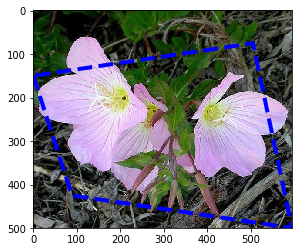

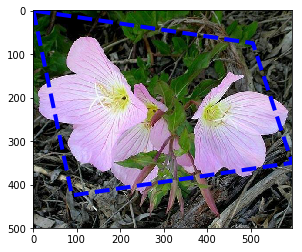

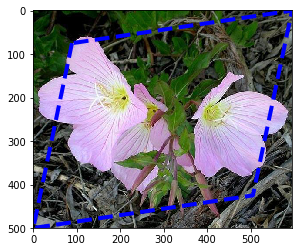

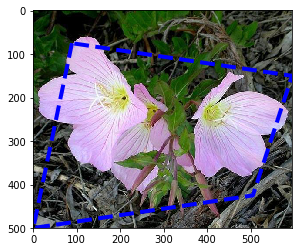

...

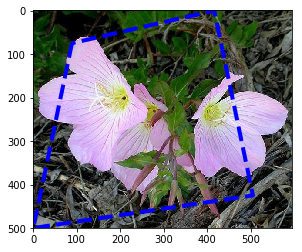

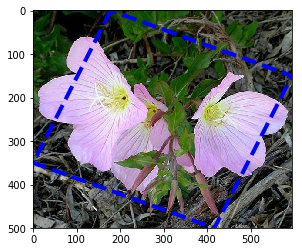

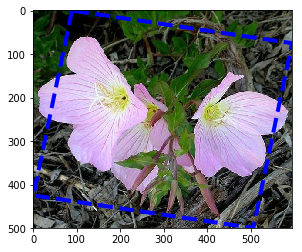

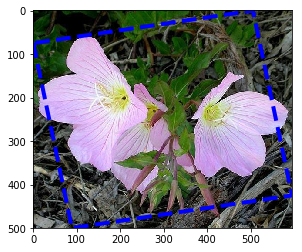

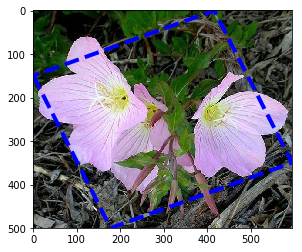

In [18]:
for s in src:
    x = [s[0][0], s[2][0], s[3][0], s[1][0], s[0][0]]
    y = [s[0][1], s[2][1], s[3][1], s[1][1], s[0][1]]
    
    plt.plot(x, y, 'b--', lw=4)
    plt.imshow(image, cmap='Greys_r')
    plt.show()

### for 1 pic

In [19]:
src_ = np.float32([(0, 0), (int(cols*(1-delta)), int(rows*delta)), (int(cols*delta), int(rows*(1-delta))), (cols, rows)])

In [20]:
x = [src_[0][0], src_[2][0], src_[3][0], src_[1][0], src_[0][0]]
y = [src_[0][1], src_[2][1], src_[3][1], src_[1][1], src_[0][1]]

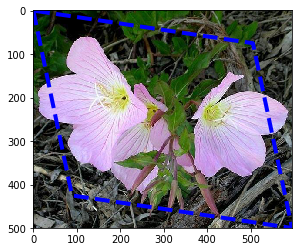

In [21]:
plt.plot(x, y, 'b--', lw=4)
plt.imshow(image, cmap='Greys_r')
plt.show()

### Perspective

In [22]:
# src = np.float32([(0, 0), (595, 0), (0, 500), (595, 500)])
# src = np.float32([(100, 100), (495, 100), (0, 500), (595, 500)])
# src = np.float32(result[15])

# src = np.float32([(100, 100), (595, 0), (0, 500), (495, 400)])
# src = np.float32([(100, 100), (495, 100), (0, 500), (595, 500)])

src__ = src[0]

In [23]:
src[0]

array([[  0.,   0.],
       [505.,  75.],
       [ 89., 425.],
       [595., 500.]], dtype=float32)

In [24]:
dst = np.float32([(595, 0), (0, 0), (595, 500), (0, 500)])

In [25]:
x = [src__[0][0], src__[2][0], src__[3][0], src__[1][0], src__[0][0]]
y = [src__[0][1], src__[2][1], src__[3][1], src__[1][1], src__[0][1]]

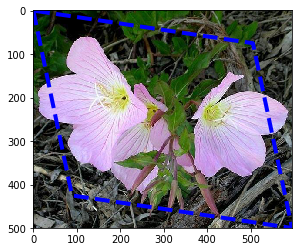

In [26]:
plt.plot(x, y, 'b--', lw=4)
plt.imshow(image, cmap='Greys_r')
plt.show()

In [27]:
# use cv2.getPerspectiveTransform() to get M, the transform matrix, and Minv, the inverse
M = cv2.getPerspectiveTransform(src__, dst)

In [28]:
warped = cv2.warpPerspective(image, M, (cols, rows), flags=cv2.INTER_LINEAR)
warped = cv2.flip(warped, 1)

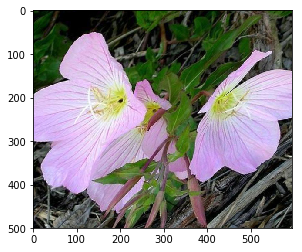

In [29]:
plt.imshow(warped)
plt.show()

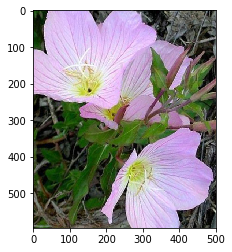

In [38]:
rotated1 = ndimage.rotate(warped, 90)

plt.imshow(rotated1)
plt.show()

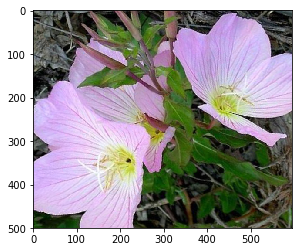

In [40]:
rotated2 = ndimage.rotate(warped, 180)

plt.imshow(rotated2)
plt.show()

### Perspective for multiple images

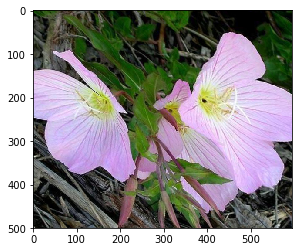

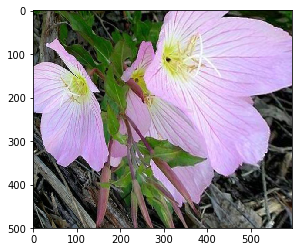

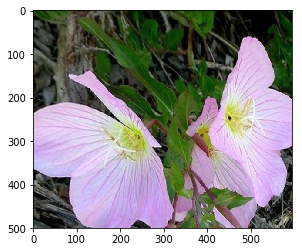

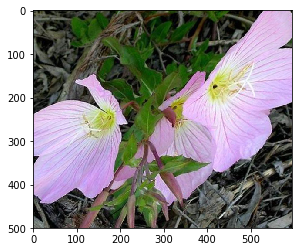

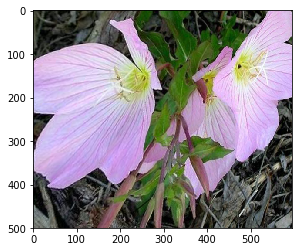

...

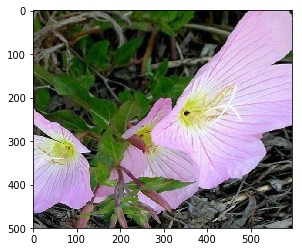

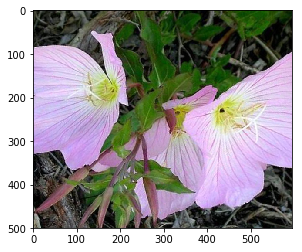

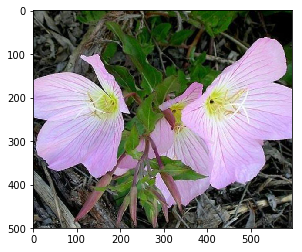

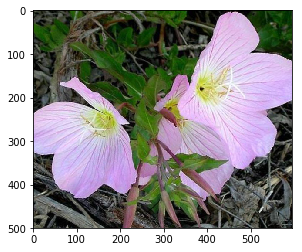

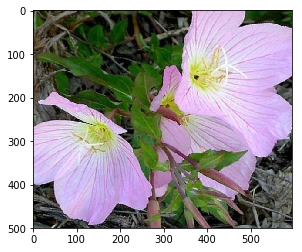

In [32]:
for s in src:
    M = cv2.getPerspectiveTransform(s, dst)
    
    warped = cv2.warpPerspective(image, M, (cols, rows), flags=cv2.INTER_LINEAR)
    
    plt.imshow(warped)
    plt.show()

### Function

In [ ]:
# generate points view
def genPoints(delta, margin):

    # top-left, top right generate
    tl = [(0+margin, 0+margin), (int(rows*delta), 0+margin), (0+margin, int(cols*delta)), (int(rows*delta), int(cols*delta))]
    tr = [(cols-margin, 0+margin), (int(cols*(1-delta)), 0+margin), (cols-margin, int(rows*delta)), 
          (int(cols*(1-delta)), int(rows*delta))]

    # bottom-left, bottom-right generate
    bl = [(0+margin, rows-margin), (0+margin, int(rows*(1-delta))), (int(cols*delta), rows-margin), 
          (int(cols*delta), int(rows*(1-delta)))]
    br = [(cols-margin, rows-margin), (int(cols*(1-delta)), rows-margin), (cols-margin, int(rows*(1-delta))), 
          (int(cols*(1-delta)), int(rows*(1-delta)))]

    result = [(x,y,z,t) for x in tl for y in tr for z in bl for t in br]
    return result

In [ ]:
delta = 0.2
margin = 30

result = genPoints(delta, margin)

In [ ]:
len(result)

In [ ]:
result[15]

In [ ]:
x = [src[0][0], src[2][0], src[3][0], src[1][0], src[0][0]]
y = [src[0][1], src[2][1], src[3][1], src[1][1], src[0][1]]

In [ ]:
plt.plot(x, y, 'b--', lw=4)
plt.imshow(image, cmap='Greys_r')
plt.show()

In [ ]:
def generateImage(image, src, dst):
    rows,cols,ch = image.shape
    
    # use cv2.getPerspectiveTransform() to get M, the transform matrix, and Minv, the inverse
    M = cv2.getPerspectiveTransform(src, dst)
    
    warped = cv2.warpPerspective(image, M, (cols, rows), flags=cv2.INTER_LINEAR)
    warped = cv2.flip(warped, 1)
    
    return warped

In [ ]:
src = np.float32(result[15])
dst = np.float32([(595, 0), (0, 0), (595, 500), (0, 500)])

In [ ]:
warped = generateImage(image, src, dst)

In [ ]:
plt.imshow(warped)
plt.show()

### Run with test image

In [ ]:
for s in result:
    src = np.float32(s)
    dst = np.float32([(595, 0), (0, 0), (595, 500), (0, 500)])
    
    warped = generateImage(image, src, dst)
    
    print(s)
    plt.imshow(warped)
    plt.show()

### another function for new point gen

In [33]:
def genImage(image, src, dst):
    rows,cols,ch = image.shape
    
    # use cv2.getPerspectiveTransform() to get M, the transform matrix, and Minv, the inverse
    M = cv2.getPerspectiveTransform(src, dst)
    
    warped = cv2.warpPerspective(image, M, (cols, rows), flags=cv2.INTER_LINEAR)
    warped = cv2.flip(warped, 1)
    
    return warped

gen img:


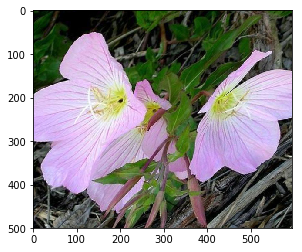

rotated:


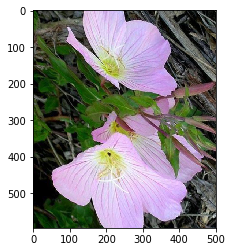

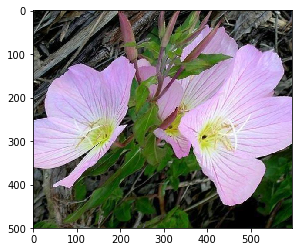

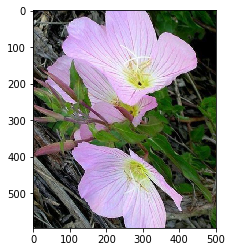

gen img:


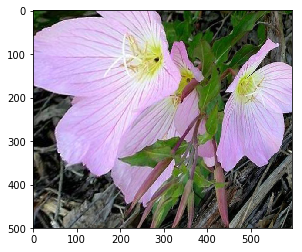

rotated:


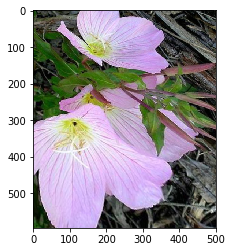

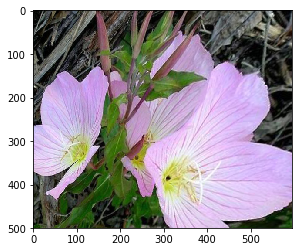

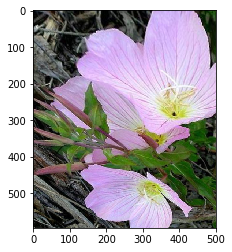

gen img:


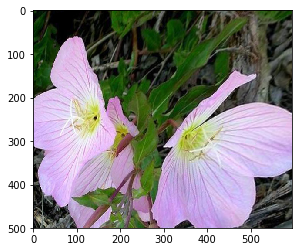

rotated:


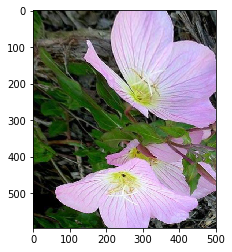

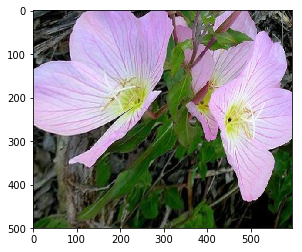

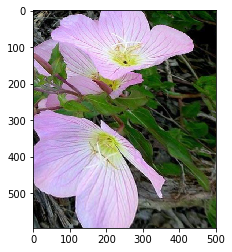

gen img:


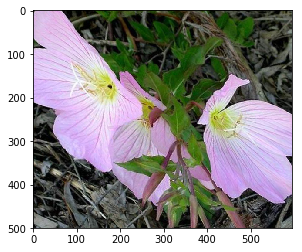

rotated:


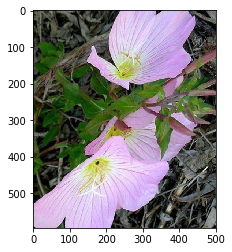

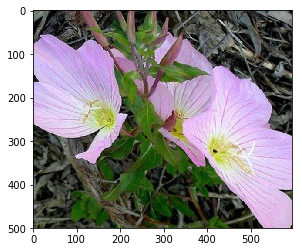

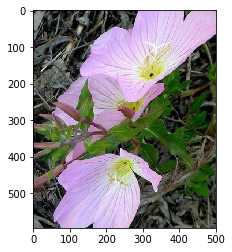

gen img:


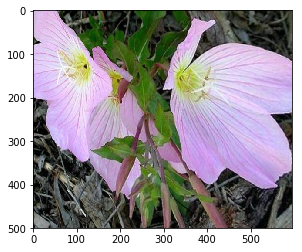

rotated:


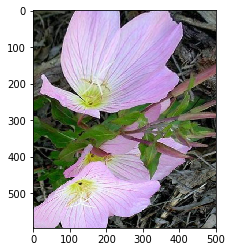

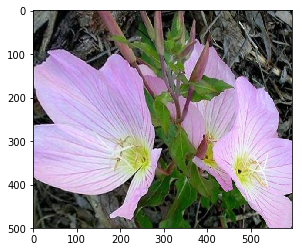

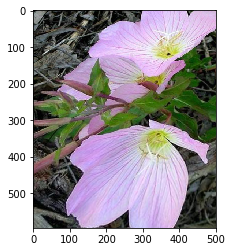

gen img:


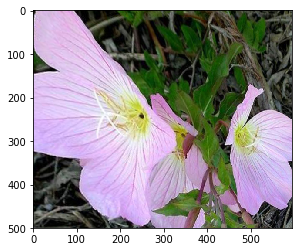

rotated:


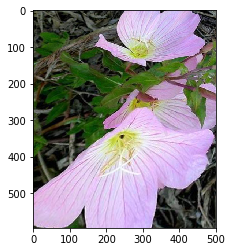

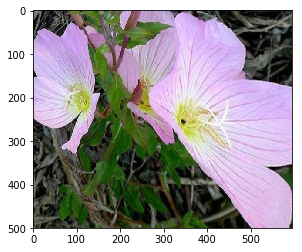

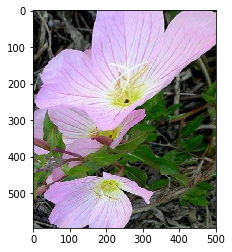

gen img:


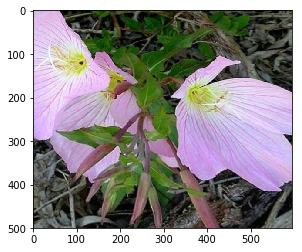

rotated:


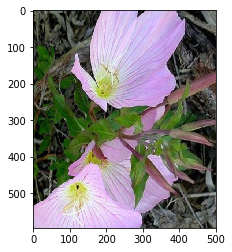

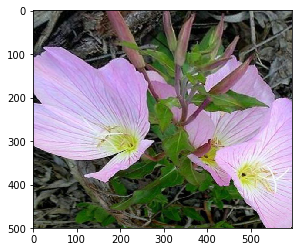

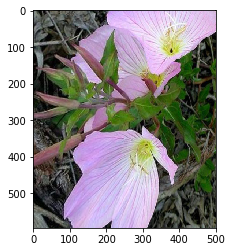

gen img:


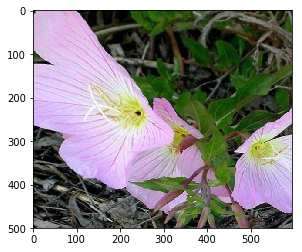

rotated:


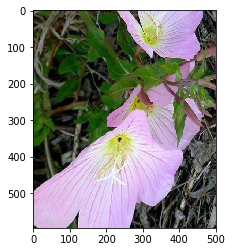

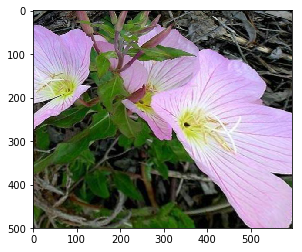

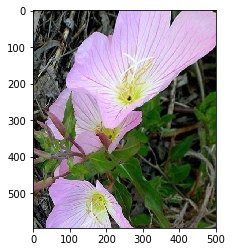

gen img:


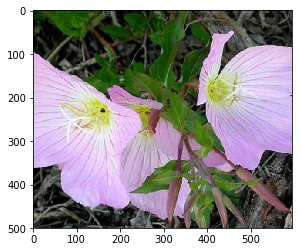

rotated:


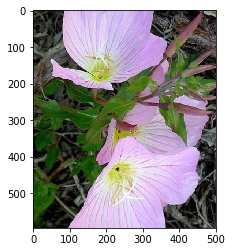

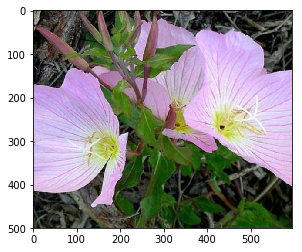

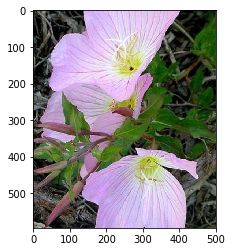

gen img:


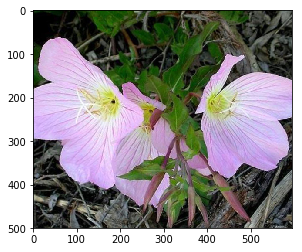

rotated:


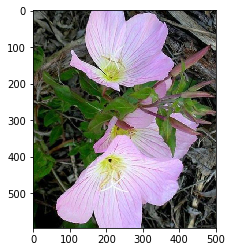

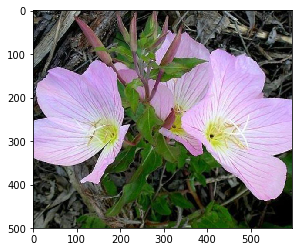

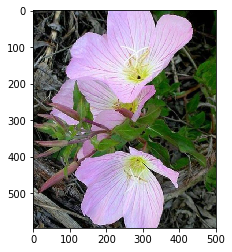

gen img:


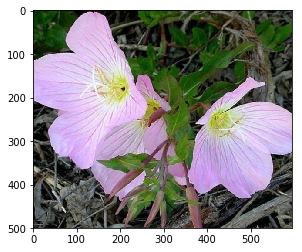

rotated:


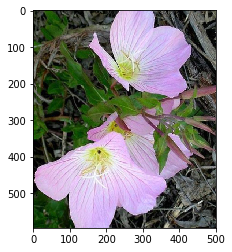

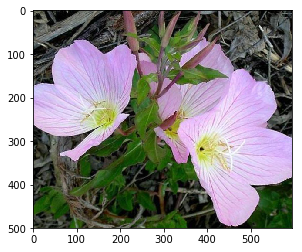

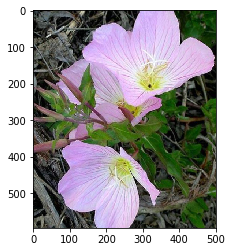

gen img:


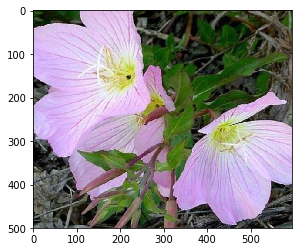

rotated:


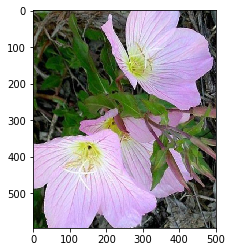

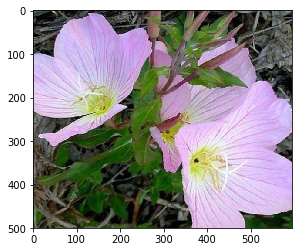

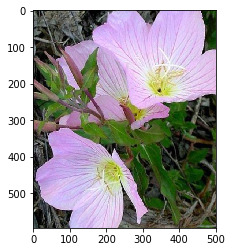

In [45]:
resultImg = {}

for ite,s in enumerate(src):
    genImg = genImage(image, s, dst)
    
    rotated1 = ndimage.rotate(genImg, 90)
    rotated2 = ndimage.rotate(genImg, 180)
    rotated3 = ndimage.rotate(genImg, 270)
    
    resultImg.update({
        str(ite): genImg,
        str(ite)+"_rotated_1": rotated1,
        str(ite)+"_rotated_2": rotated2,
        str(ite)+"_rotated_3": rotated3,
    })
    
    
    print("gen img:")
    plt.imshow(genImg)
    plt.show()
    
    print("rotated:")
    plt.imshow(rotated1)
    plt.show()
    plt.imshow(rotated2)
    plt.show()
    plt.imshow(rotated3)
    plt.show()
    


In [46]:
len(resultImg)

48

9_rotated_3


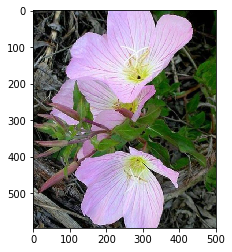

3_rotated_2


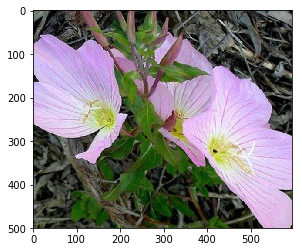

3


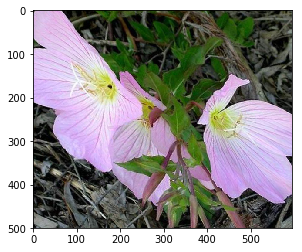

11_rotated_3


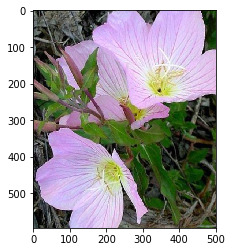

5_rotated_2


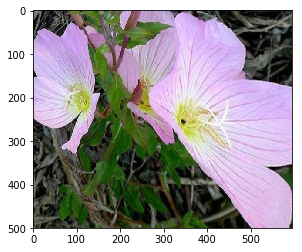

6


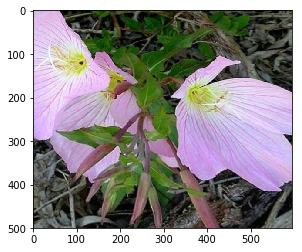

6_rotated_1


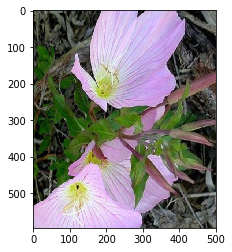

5_rotated_3


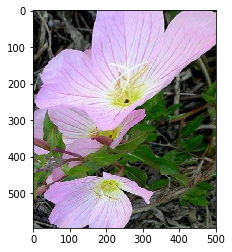

4_rotated_1


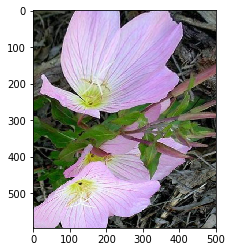

9_rotated_2


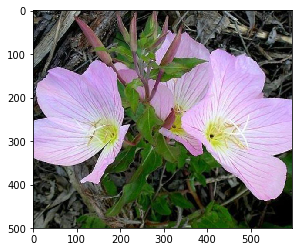

0


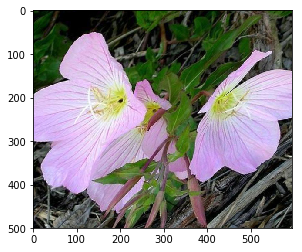

8_rotated_2


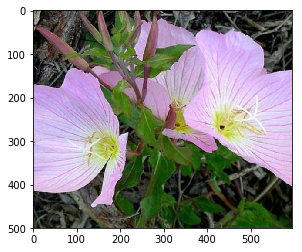

1


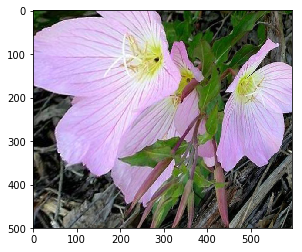

6_rotated_3


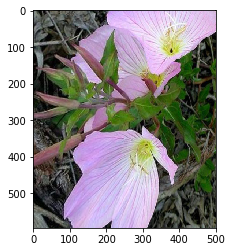

0_rotated_1


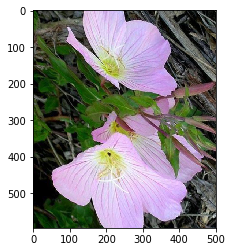

11


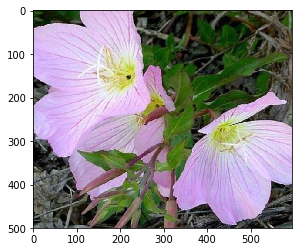

1_rotated_3


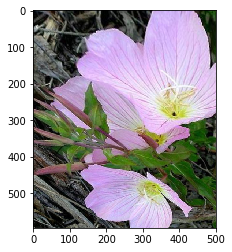

5


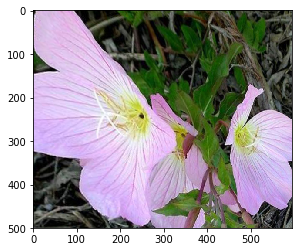

8


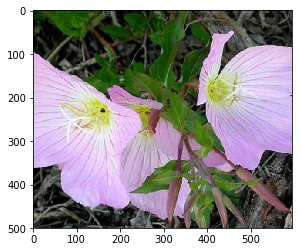

11_rotated_2


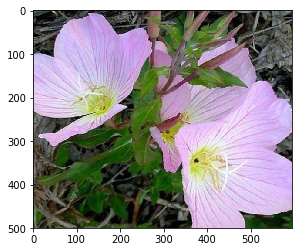

1_rotated_1


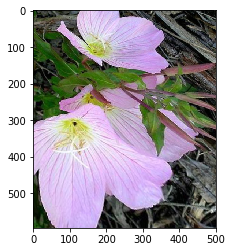

4_rotated_3


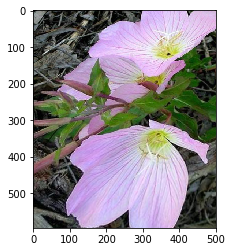

0_rotated_3


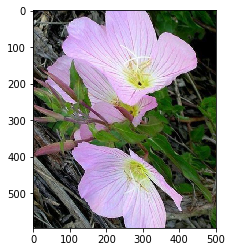

10_rotated_1


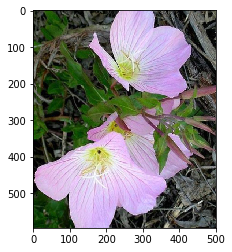

7_rotated_2


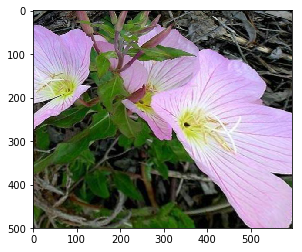

0_rotated_2


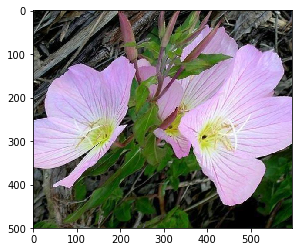

6_rotated_2


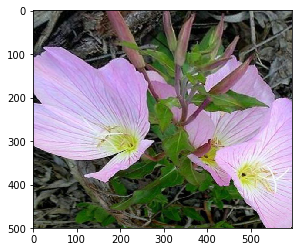

2


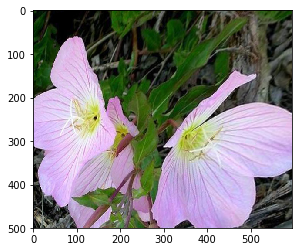

9_rotated_1


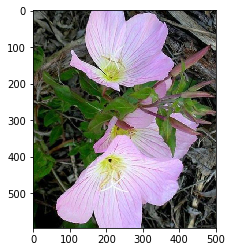

7


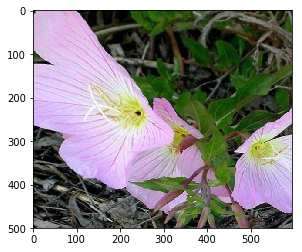

8_rotated_1


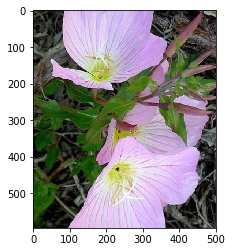

3_rotated_1


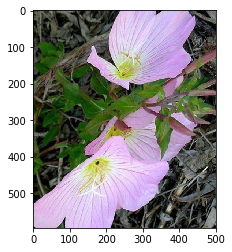

11_rotated_1


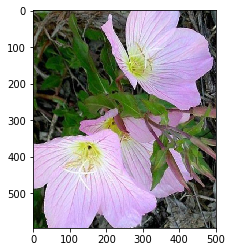

2_rotated_1


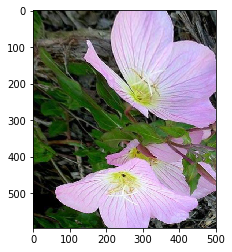

3_rotated_3


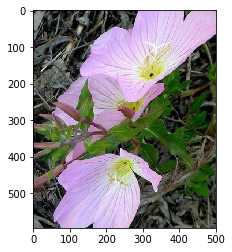

5_rotated_1


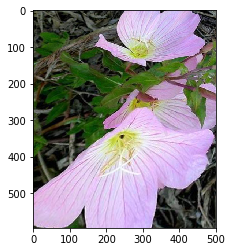

7_rotated_1


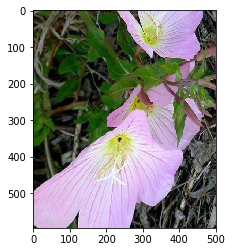

8_rotated_3


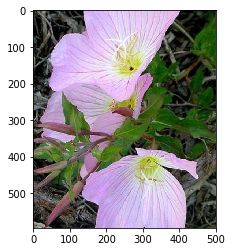

9


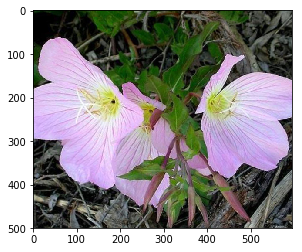

4


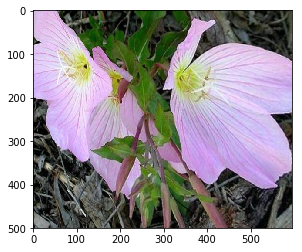

10_rotated_3


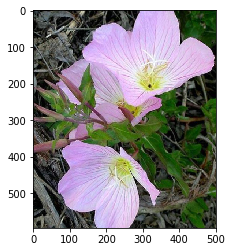

4_rotated_2


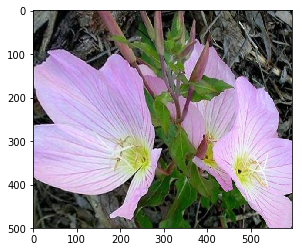

2_rotated_3


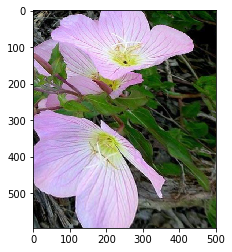

7_rotated_3


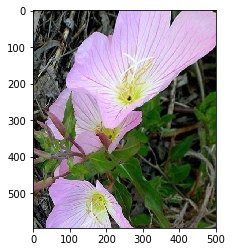

10_rotated_2


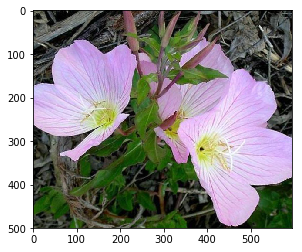

1_rotated_2


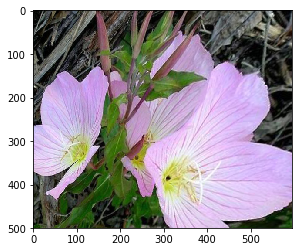

2_rotated_2


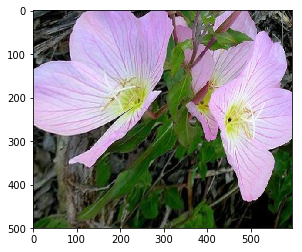

10


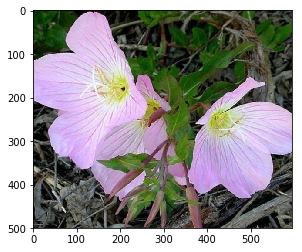

In [51]:
for key,val in resultImg.items():
    print(key)
    plt.imshow(val)
    plt.show()

### Final function

In [47]:
def pointGen(delta, cols, rows):
    src1 = np.float32([(0, 0), (int(cols*(1-delta)), int(rows*delta)), (int(cols*delta), int(rows*(1-delta))), (cols, rows)])

    src2 = np.float32([(0, int(rows*2*delta)), (int(cols*(1-delta)), int(rows*delta)), 
                      (int(cols*delta), int(rows*(1-delta))), (cols, rows)])
    src3 = np.float32([(0, 0), (int(cols*(1-delta)), int(rows*delta)), 
                      (int(cols*delta), int(rows*(1-delta))), (cols, int(rows*(1-2*delta)))])

    src4 = np.float32([(int(cols*delta), int(rows*delta)), (cols, 0), (0, rows), (int(cols*(1-delta)), int(rows*(1-delta)))])

    src5 = np.float32([(int(cols*delta), int(rows*delta)), (cols, int(rows*2*delta)), 
                      (0, rows), (int(cols*(1-delta)), int(rows*(1-delta)))])
    src6 = np.float32([(int(cols*delta), int(rows*delta)), (cols, 0), 
                      (0, rows*(1-2*delta)), (int(cols*(1-delta)), int(rows*(1-delta)))])

    src7 = np.float32([(int(cols*delta), int(rows*delta)), (cols, 0), (int(cols*2*delta), rows), 
                      (int(cols*(1-delta)), int(rows*(1-delta)))])
    src8 = np.float32([(int(cols*delta), int(rows*delta)), (int(cols*(1-2*delta)), 0), (0, rows), 
                      (int(cols*(1-delta)), int(rows*(1-delta)))])

    src9 = np.float32([(int(cols*2*delta), 0), (cols, int(rows*2*delta)), (0, rows*(1-2*delta)), (cols*(1-2*delta), rows)])
    src10 = np.float32([(int(cols*delta), 0), (cols, int(rows*delta)), (0, int(rows*(1-delta))), (cols*(1-delta), rows)])

    src11 = np.float32([(0, int(rows*delta)), (int(cols*(1-delta)), 0), (int(cols*delta), rows), (cols, int(rows*(1-delta)))])
    src12 = np.float32([(0, int(rows*2*delta)), (int(cols*(1-2*delta)), 0), 
                        (int(cols*2*delta), rows), (cols, int(rows*(1-2*delta)))])
    
    src = [src1, src2, src3, src4, src5, src6, src7, src8, src9, src10, src11, src12]
    
    return src

In [76]:
def perspectiveImg(img_path, img_name):
    # read image
    image = cv2.imread(data_folder+filename)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # get height width of images
    rows,cols,ch = image.shape
    # set source and destination points
    src = pointGen(delta=0.15, cols=cols, rows=rows)
    dst = np.float32([(cols, 0), (0, 0), (cols, rows), (0, rows)])
    
    # set firstname of image
    fname = str(img_name.split(".")[:-1][0])
    lname = "." + str(img_name.split(".")[-1])
    
    resultImg = {}

    for ite,s in enumerate(src):
        genImg = genImage(image, s, dst)

        rotated1 = ndimage.rotate(genImg, 90)
        rotated2 = ndimage.rotate(genImg, 180)
        rotated3 = ndimage.rotate(genImg, 270)

        resultImg.update({
            fname + str(ite) + lname: genImg,
            fname + str(ite) + "_rotated_1" + lname: rotated1,
            fname + str(ite) + "_rotated_2" + lname: rotated2,
            fname + str(ite) + "_rotated_3" + lname: rotated3,
        })
    
    return resultImg    

In [77]:
filename = "image_06737.jpg"
data_folder = "./data/flower_data/train/1/"

In [78]:
res = perspectiveImg(img_path=data_folder, img_name=filename)

image_067374_rotated_1.jpg


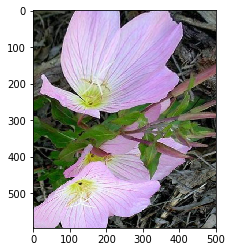

image_067377_rotated_1.jpg


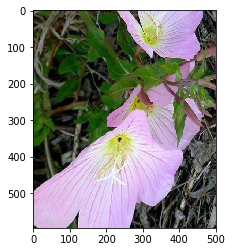

image_067370.jpg


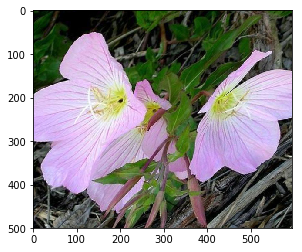

image_067376_rotated_3.jpg


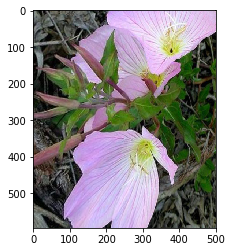

image_067371_rotated_2.jpg


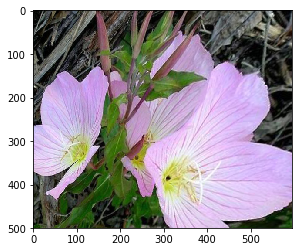

image_067379_rotated_2.jpg


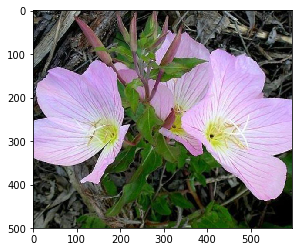

image_067378.jpg


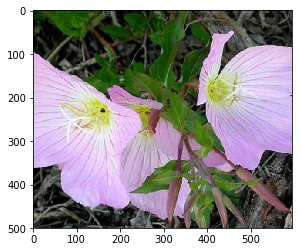

image_067372_rotated_2.jpg


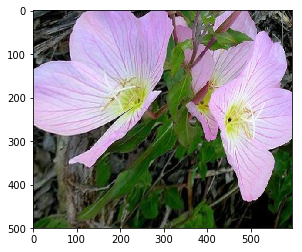

image_067372_rotated_3.jpg


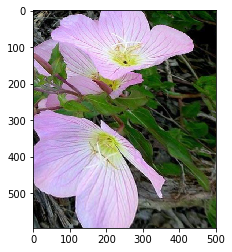

image_067378_rotated_2.jpg


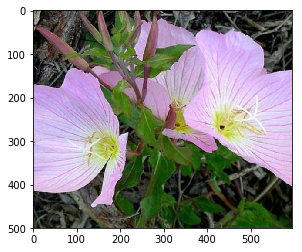

image_067379_rotated_3.jpg


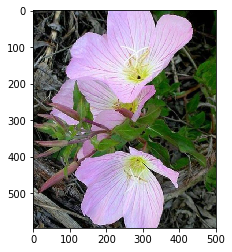

image_0673711_rotated_3.jpg


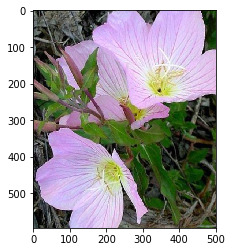

image_0673711_rotated_1.jpg


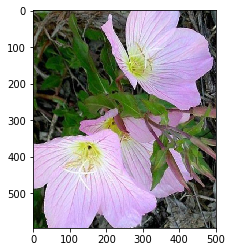

image_0673710_rotated_2.jpg


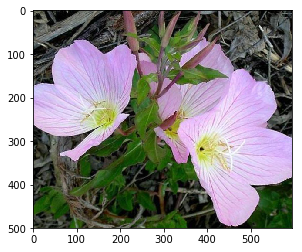

image_067373.jpg


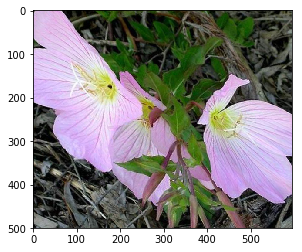

image_0673710_rotated_1.jpg


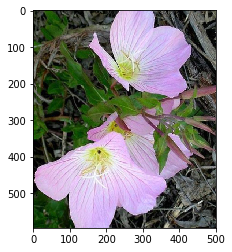

image_067379_rotated_1.jpg


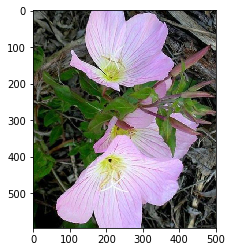

image_067372.jpg


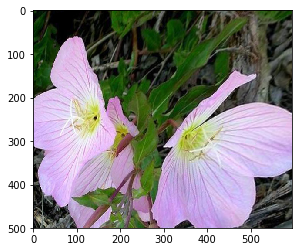

image_067375_rotated_1.jpg


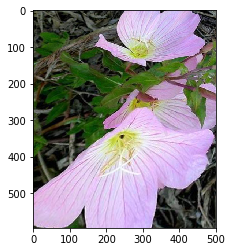

image_067376.jpg


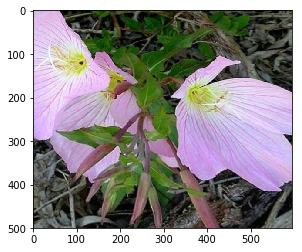

image_067377_rotated_2.jpg


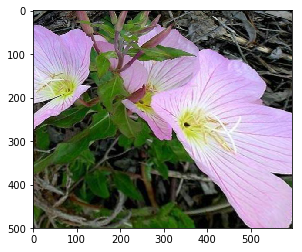

image_067379.jpg


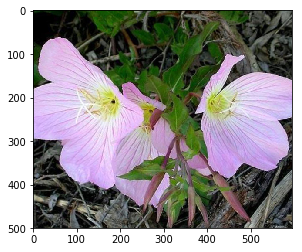

image_067373_rotated_1.jpg


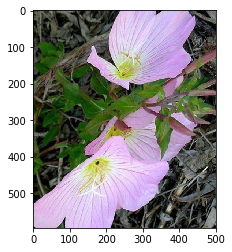

image_067371.jpg


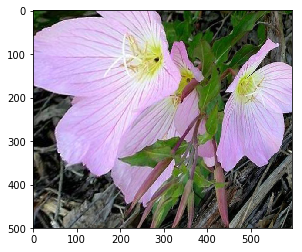

image_067376_rotated_1.jpg


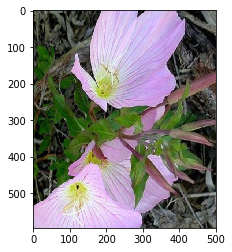

image_067375.jpg


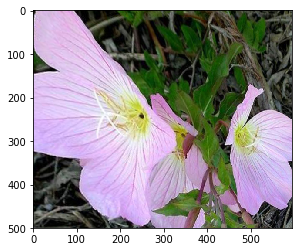

image_0673711.jpg


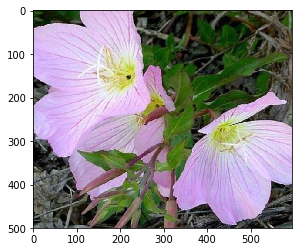

image_067377_rotated_3.jpg


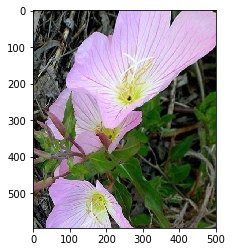

image_067377.jpg


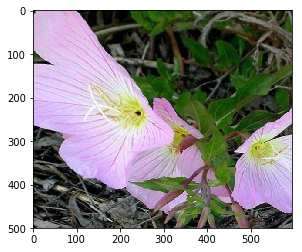

image_067378_rotated_1.jpg


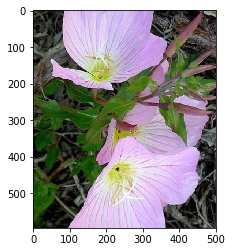

image_067374_rotated_2.jpg


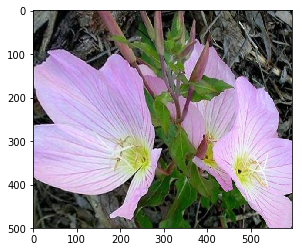

image_0673711_rotated_2.jpg


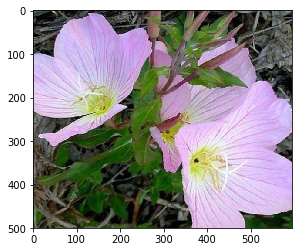

image_067378_rotated_3.jpg


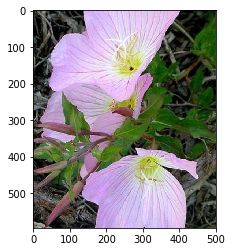

image_067373_rotated_2.jpg


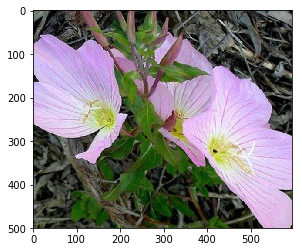

image_067370_rotated_2.jpg


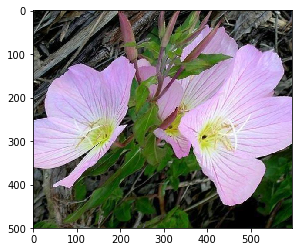

image_067371_rotated_1.jpg


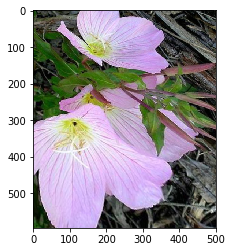

image_067376_rotated_2.jpg


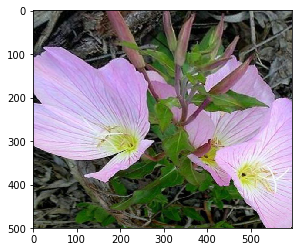

image_067375_rotated_3.jpg


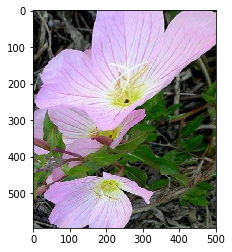

image_067375_rotated_2.jpg


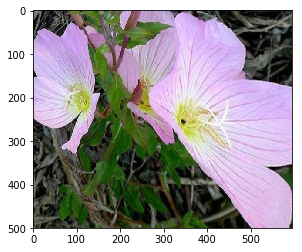

image_067370_rotated_3.jpg


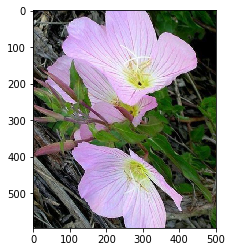

image_0673710_rotated_3.jpg


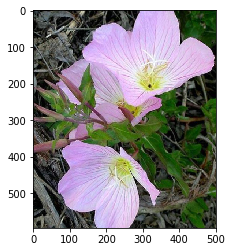

image_0673710.jpg


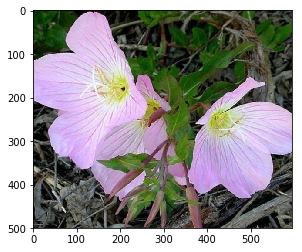

image_067370_rotated_1.jpg


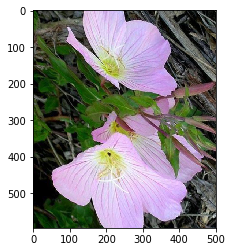

image_067372_rotated_1.jpg


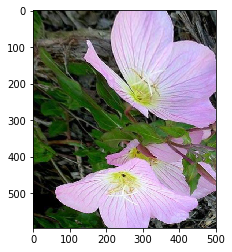

image_067373_rotated_3.jpg


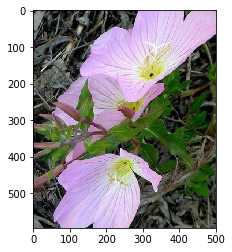

image_067371_rotated_3.jpg


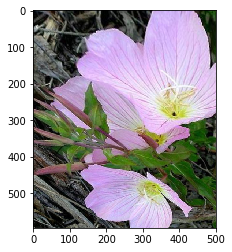

image_067374_rotated_3.jpg


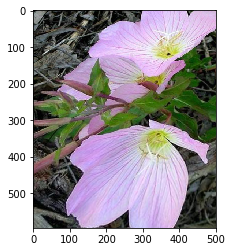

image_067374.jpg


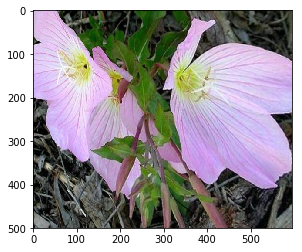

In [79]:
for key,val in res.items():
    print(key)
    plt.imshow(val)
    plt.show()

### Read os

In [83]:
train_folder = "./data/flower_data/train/"
folder_list = []
folder_list = os.listdir(path=train_folder)

In [80]:
# Check and create folder if it's not exist
def checkFolderExist(folder_path):
    if (os.path.exists(folder_path) == True):
        print("This folder "+ folder_path +" is already exist")
    else:
        os.makedirs(folder_path)

In [81]:
train_augmentation = "./data/flower_data/train_augmentation/"

In [84]:
for folder in folder_list:
    checkFolderExist(train_augmentation + folder)

This folder ./data/flower_data/train_augmentation/1 is already exist
This folder ./data/flower_data/train_augmentation/10 is already exist
This folder ./data/flower_data/train_augmentation/100 is already exist
This folder ./data/flower_data/train_augmentation/101 is already exist
This folder ./data/flower_data/train_augmentation/102 is already exist
This folder ./data/flower_data/train_augmentation/11 is already exist
This folder ./data/flower_data/train_augmentation/12 is already exist
This folder ./data/flower_data/train_augmentation/13 is already exist
This folder ./data/flower_data/train_augmentation/14 is already exist
This folder ./data/flower_data/train_augmentation/15 is already exist
This folder ./data/flower_data/train_augmentation/16 is already exist
This folder ./data/flower_data/train_augmentation/17 is already exist
This folder ./data/flower_data/train_augmentation/18 is already exist
This folder ./data/flower_data/train_augmentation/19 is already exist
This folder ./data

In [88]:
# show all image in folder
for folder in folder_list:
    img_path = train_folder + folder
    
    print("train folder:", img_path)

    for imp in img_path:
        filename = os.listdir(img_path)
    
    

train folder: ./data/flower_data/train/1
train folder: ./data/flower_data/train/10
train folder: ./data/flower_data/train/100
train folder: ./data/flower_data/train/101
train folder: ./data/flower_data/train/102
train folder: ./data/flower_data/train/11
train folder: ./data/flower_data/train/12
train folder: ./data/flower_data/train/13
train folder: ./data/flower_data/train/14
train folder: ./data/flower_data/train/15
train folder: ./data/flower_data/train/16
train folder: ./data/flower_data/train/17
train folder: ./data/flower_data/train/18
train folder: ./data/flower_data/train/19
train folder: ./data/flower_data/train/2
train folder: ./data/flower_data/train/20
train folder: ./data/flower_data/train/21
train folder: ./data/flower_data/train/22
train folder: ./data/flower_data/train/23
train folder: ./data/flower_data/train/24
train folder: ./data/flower_data/train/25
train folder: ./data/flower_data/train/26
train folder: ./data/flower_data/train/27
train folder: ./data/flower_data/

In [87]:
os.listdir("./data/flower_data/train/1")

['image_06734.jpg',
 'image_06735.jpg',
 'image_06736.jpg',
 'image_06737.jpg',
 'image_06738.jpg',
 'image_06740.jpg',
 'image_06741.jpg',
 'image_06742.jpg',
 'image_06744.jpg',
 'image_06745.jpg',
 'image_06746.jpg',
 'image_06747.jpg',
 'image_06748.jpg',
 'image_06750.jpg',
 'image_06751.jpg',
 'image_06753.jpg',
 'image_06757.jpg',
 'image_06759.jpg',
 'image_06761.jpg',
 'image_06762.jpg',
 'image_06766.jpg',
 'image_06767.jpg',
 'image_06768.jpg',
 'image_06770.jpg',
 'image_06771.jpg',
 'image_06772.jpg',
 'image_06773.jpg']